In [94]:
from PIL import Image
import pandas as pd
from PIL import Image
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2  # For resizing the images


# EDA - Dataset

## Number of Images

In [95]:
# Directories
images_dir = './Dataset_new/images'
masks_dir = './Dataset_new/masks'

# Initialize output
image_files = {}

# List all files in images and masks directories
image_files = [f for f in os.listdir(images_dir) if f.endswith('.jpg') and f in os.listdir(masks_dir)]

print(f'Found {len(image_files)} images')

Found 1000 images


## Distribution of Mask & Image Sizes

Durchschnittliche Bildgröße: [822.292 656.902]
Durchschnittliche Maskengröße: [822.292 656.902]
Durchschnittlicher Anteil der weißen Pixel: 10.458977406905895%


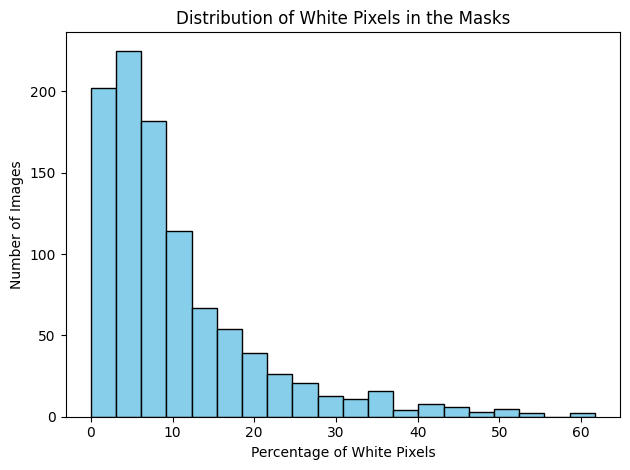

In [96]:
# Initialize lists to store results
image_sizes = []
mask_sizes = []
white_pixel_percentages = []

# Loop through each image file
for image_file in os.listdir(images_dir):
    if image_file.endswith('.jpg') and image_file in os.listdir(masks_dir):
        # Load image and mask
        image_path = os.path.join(images_dir, image_file)
        mask_path = os.path.join(masks_dir, image_file)

        image = Image.open(image_path)
        mask = Image.open(mask_path)

        # Convert mask to grayscale (if not already)
        mask = mask.convert('L')

        # Get image size (width, height)
        image_width, image_height = image.size
        image_sizes.append((image_width, image_height))

        # Get mask size (width, height)
        mask_width, mask_height = mask.size
        mask_sizes.append((mask_width, mask_height))

        # Convert mask to numpy array for easier analysis
        mask_array = np.array(mask)

        # Calculate percentage of white pixels in mask
        total_pixels = mask_array.size
        white_pixels = np.sum(mask_array == 255)  # white pixels are 255 in the mask
        white_pixel_percentage = (white_pixels / total_pixels) * 100
        white_pixel_percentages.append(white_pixel_percentage)

# Convert to numpy arrays for easier processing
image_sizes = np.array(image_sizes)
mask_sizes = np.array(mask_sizes)
white_pixel_percentages = np.array(white_pixel_percentages)

# Print some statistics
print(f"Durchschnittliche Bildgröße: {np.mean(image_sizes, axis=0)}")
print(f"Durchschnittliche Maskengröße: {np.mean(mask_sizes, axis=0)}")
print(f"Durchschnittlicher Anteil der weißen Pixel: {np.mean(white_pixel_percentages)}%")

# Visualize the distribution of white pixel percentages
plt.hist(white_pixel_percentages, bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of White Pixels in the Masks')
plt.xlabel('Percentage of White Pixels')
plt.ylabel('Number of Images')

# tight layout
plt.tight_layout()
plt.savefig('Grafiken_EDA/distribution_masksize.png')
plt.show()


### How much % of the image is removed on average?

- An average of 10.45% white pixels means that about 10.45% of the total area of an image or mask contains white pixels (the removed area).

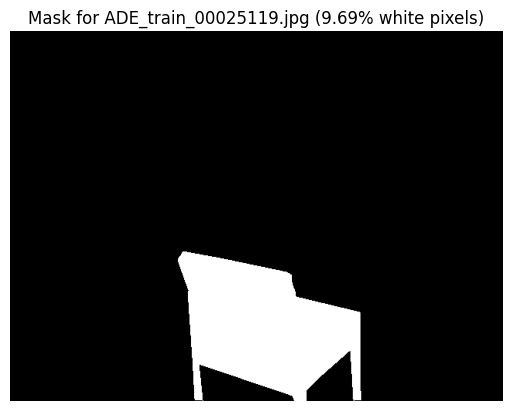

In [97]:
# Threshold for the percentage of white pixels (10.45%)
target_percentage = 10.45

# List to store masks with their white pixel percentage
matching_masks = []

# Loop through each image file
for image_file in os.listdir(images_dir):
    if image_file.endswith('.jpg') and image_file in os.listdir(masks_dir):
        # Load mask
        mask_path = os.path.join(masks_dir, image_file)
        mask = Image.open(mask_path)

        # Convert mask to grayscale (if not already)
        mask = mask.convert('L')

        # Convert mask to numpy array for easier analysis
        mask_array = np.array(mask)

        # Calculate percentage of white pixels in the mask
        total_pixels = mask_array.size
        white_pixels = np.sum(mask_array == 255)  # white pixels are 255 in the mask
        white_pixel_percentage = (white_pixels / total_pixels) * 100

        # If the percentage is close to the target percentage, save the mask
        if np.isclose(white_pixel_percentage, target_percentage, atol=1):  # tolerance of 1% difference
            matching_masks.append((image_file, white_pixel_percentage, mask))

# If a match is found, display the first matching mask
if matching_masks:
    # Get the first matching mask
    image_file, white_pixel_percentage, mask = matching_masks[0]

    # Display the mask
    plt.imshow(mask, cmap='gray')
    plt.title(f'Mask for {image_file} ({white_pixel_percentage:.2f}% white pixels)')
    plt.axis('off')
    plt.show()

else:
    print("No mask found with approximately 10.45% white pixels.")

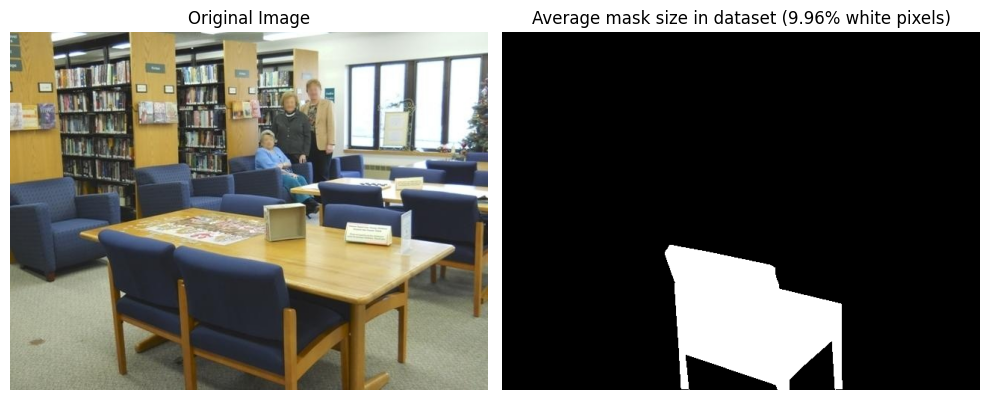

In [98]:
img_avg = 'Dataset_new/images/ADE_train_00025119.jpg'
mask_avg = 'Dataset_new/masks/ADE_train_00025119.jpg'

# Load the images
img = mpimg.imread(img_avg)
mask = mpimg.imread(mask_avg)



# Create a figure and axis to place the images
fig, ax = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns

# Display images
ax[0].imshow(img)
ax[0].axis('off')  # Hide axis for the first image
ax[0].set_title('Original Image')  # Add caption for the first image

ax[1].imshow(mask, cmap='gray')
ax[1].axis('off')  # Hide axis for the second image
ax[1].set_title('Average mask size in dataset (9.96% white pixels)')  # Add caption for the second image

# Adjust layout and save the plot
plt.tight_layout()  # Adjust layout to fit the images
plt.savefig('Grafiken_EDA/averagemasksize_example.jpg')
plt.show()


## Result Inpainting Analysis: Mask Size

### Results small mask size

In [99]:
# Function to load and resize images to the same size
def load_and_resize(image_path, size=(256, 256)):
    img = cv2.imread(image_path)  # Load image using OpenCV
    img_resized = cv2.resize(img, size)  # Resize image to the given size
    return cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB

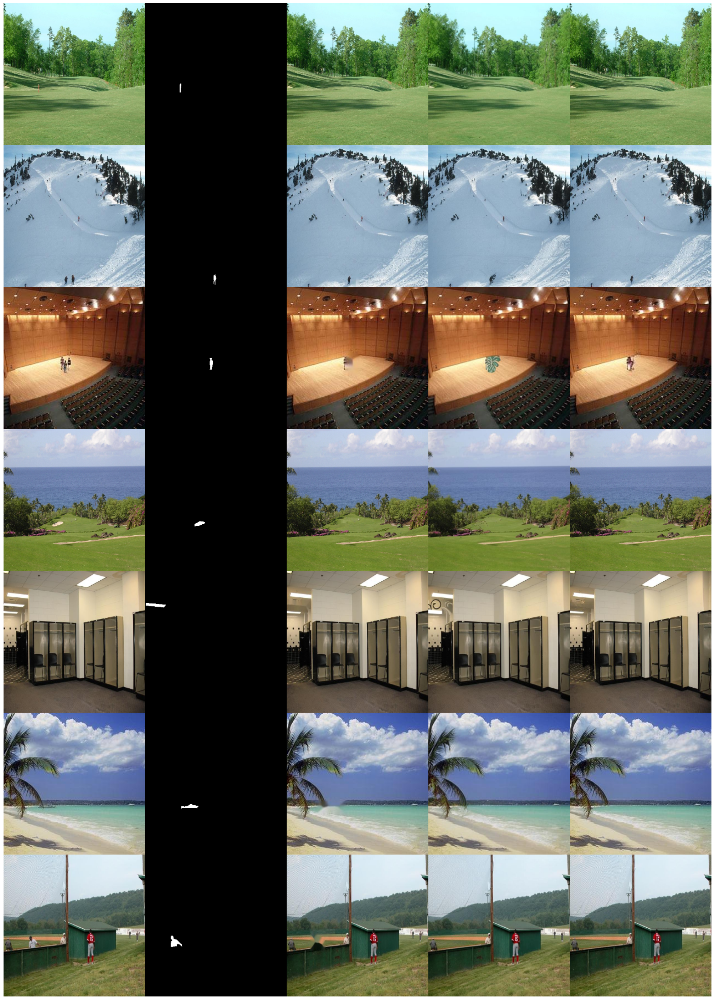

In [100]:
# List of image and corresponding mask paths
image_paths = [
    'Dataset_new/images/ADE_train_00007691.jpg',
    'Dataset_new/images/ADE_train_00016349.jpg',
    'Dataset_new/images/ADE_train_00019155.jpg',
    'Dataset_new/images/ADE_train_00007692.jpg',
    'Dataset_new/images/ADE_train_00011598.jpg',
    'Dataset_new/images/ADE_train_00003114.jpg',
    'Dataset_new/images/ADE_train_00007502.jpg'
]

# List of corresponding mask paths (assuming the mask paths are named similarly)
mask_paths = [
    'Dataset_new/masks/ADE_train_00007691.jpg',
    'Dataset_new/masks/ADE_train_00016349.jpg',
    'Dataset_new/masks/ADE_train_00019155.jpg',
    'Dataset_new/masks/ADE_train_00007692.jpg',
    'Dataset_new/masks/ADE_train_00011598.jpg',
    'Dataset_new/masks/ADE_train_00003114.jpg',
    'Dataset_new/masks/ADE_train_00007502.jpg'
]

# List of corresponding OpenCV paths (assuming the same naming pattern)
opencv_paths = [
    'results/opencv/ADE_train_00007691.jpg',
    'results/opencv/ADE_train_00016349.jpg',
    'results/opencv/ADE_train_00019155.jpg',
    'results/opencv/ADE_train_00007692.jpg',
    'results/opencv/ADE_train_00011598.jpg',
    'results/opencv/ADE_train_00003114.jpg',
    'results/opencv/ADE_train_00007502.jpg'
]

# List of corresponding SD paths
sd_paths = [
    'results/sd/ADE_train_00007691.jpg',
    'results/sd/ADE_train_00016349.jpg',
    'results/sd/ADE_train_00019155.jpg',
    'results/sd/ADE_train_00007692.jpg',
    'results/sd/ADE_train_00011598.jpg',
    'results/sd/ADE_train_00003114.jpg',
    'results/sd/ADE_train_00007502.jpg'
]

# List of corresponding LAMA paths
lama_paths = [
    'results/lama/ADE_train_00007691.jpg',
    'results/lama/ADE_train_00016349.jpg',
    'results/lama/ADE_train_00019155.jpg',
    'results/lama/ADE_train_00007692.jpg',
    'results/lama/ADE_train_00011598.jpg',
    'results/lama/ADE_train_00003114.jpg',
    'results/lama/ADE_train_00007502.jpg'
]


# Create a figure to hold the images
fig, ax = plt.subplots(len(image_paths), 5, figsize=(20, len(image_paths)*4))  # 5 columns: image, mask, opencv, sd, lama

# Loop through each image path and its corresponding mask
for i in range(len(image_paths)):
    # Load and resize all images
    img = load_and_resize(image_paths[i])
    mask = load_and_resize(mask_paths[i])
    opencv_img = load_and_resize(opencv_paths[i])
    sd_img = load_and_resize(sd_paths[i])
    lama_img = load_and_resize(lama_paths[i])

    # Display the original image
    ax[i, 0].imshow(img)
    ax[i, 0].axis('off')
    
    # Display the mask
    ax[i, 1].imshow(mask, cmap='gray')
    ax[i, 1].axis('off')
    
    # Display the OpenCV result
    ax[i, 2].imshow(opencv_img)
    ax[i, 2].axis('off')
    
    # Display the SD result
    ax[i, 3].imshow(sd_img)
    ax[i, 3].axis('off')
    
    # Display the LAMA result
    ax[i, 4].imshow(lama_img)
    ax[i, 4].axis('off')

# Adjust layout to remove padding and gaps between images
plt.subplots_adjust(wspace=0, hspace=0)  # Remove horizontal and vertical spacing
plt.tight_layout(pad=0)  # Ensures there’s no extra padding around the image grid
plt.savefig('Grafiken_EDA/results_smallmask.jpg')
plt.show()


### Results medium mask size

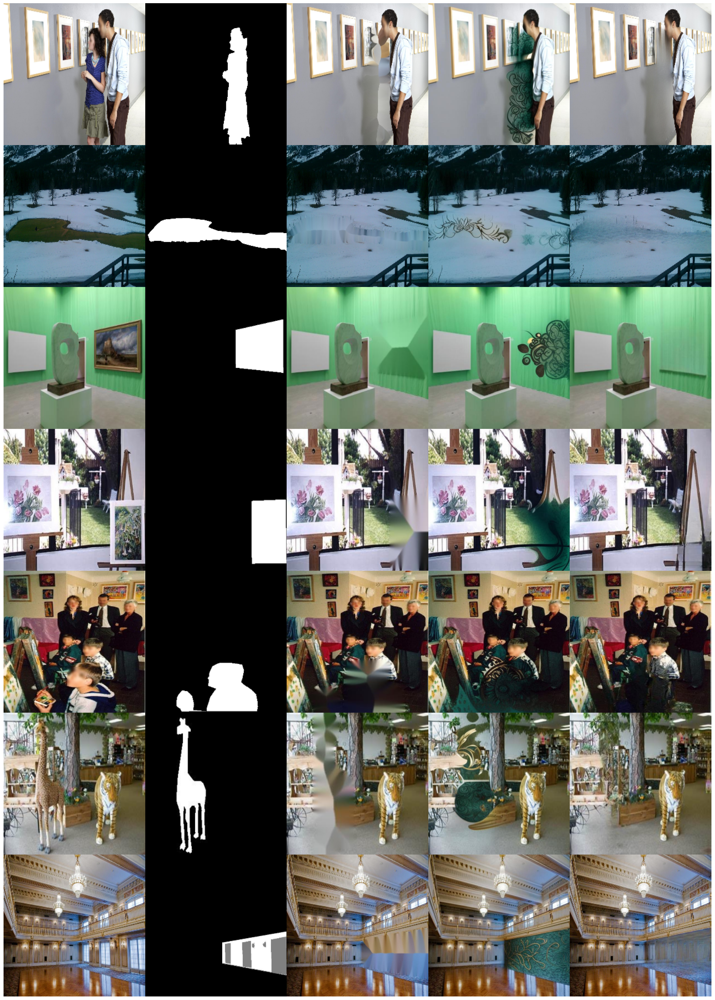

In [101]:
# List of image and corresponding mask paths
image_paths = [
    'Dataset_new/images/ADE_train_00001652.jpg',
    'Dataset_new/images/ADE_train_00024430.jpg',
    'Dataset_new/images/ADE_train_00001699.jpg',
    'Dataset_new/images/ADE_train_00001737.jpg',
    'Dataset_new/images/ADE_train_00001704.jpg',
    'Dataset_new/images/ADE_train_00019298.jpg',
    'Dataset_new/images/ADE_train_00002273.jpg'
]

# List of corresponding mask paths (assuming the mask paths are named similarly)
mask_paths = [
    'Dataset_new/masks/ADE_train_00001652.jpg',
    'Dataset_new/masks/ADE_train_00024430.jpg',
    'Dataset_new/masks/ADE_train_00001699.jpg',
    'Dataset_new/masks/ADE_train_00001737.jpg',
    'Dataset_new/masks/ADE_train_00001704.jpg',
    'Dataset_new/masks/ADE_train_00019298.jpg',
    'Dataset_new/masks/ADE_train_00002273.jpg'
]

# List of corresponding OpenCV paths (assuming the same naming pattern)
opencv_paths = [
    'results/opencv/ADE_train_00001652.jpg',
    'results/opencv/ADE_train_00024430.jpg',
    'results/opencv/ADE_train_00001699.jpg',
    'results/opencv/ADE_train_00001737.jpg',
    'results/opencv/ADE_train_00001704.jpg',
    'results/opencv/ADE_train_00019298.jpg',
    'results/opencv/ADE_train_00002273.jpg'
]

# List of corresponding SD paths
sd_paths = [
    'results/sd/ADE_train_00001652.jpg',
    'results/sd/ADE_train_00024430.jpg',
    'results/sd/ADE_train_00001699.jpg',
    'results/sd/ADE_train_00001737.jpg',
    'results/sd/ADE_train_00001704.jpg',
    'results/sd/ADE_train_00019298.jpg',
    'results/sd/ADE_train_00002273.jpg'
]

# List of corresponding LAMA paths
lama_paths = [
    'results/lama/ADE_train_00001652.jpg',
    'results/lama/ADE_train_00024430.jpg',
    'results/lama/ADE_train_00001699.jpg',
    'results/lama/ADE_train_00001737.jpg',
    'results/lama/ADE_train_00001704.jpg',
    'results/lama/ADE_train_00019298.jpg',
    'results/lama/ADE_train_00002273.jpg'
]


# Create a figure to hold the images
fig, ax = plt.subplots(len(image_paths), 5, figsize=(20, len(image_paths)*4))  # 5 columns: image, mask, opencv, sd, lama

# Loop through each image path and its corresponding mask
for i in range(len(image_paths)):
    # Load and resize all images
    img = load_and_resize(image_paths[i])
    mask = load_and_resize(mask_paths[i])
    opencv_img = load_and_resize(opencv_paths[i])
    sd_img = load_and_resize(sd_paths[i])
    lama_img = load_and_resize(lama_paths[i])

    # Display the original image
    ax[i, 0].imshow(img)
    ax[i, 0].axis('off')
    
    # Display the mask
    ax[i, 1].imshow(mask, cmap='gray')
    ax[i, 1].axis('off')
    
    # Display the OpenCV result
    ax[i, 2].imshow(opencv_img)
    ax[i, 2].axis('off')
    
    # Display the SD result
    ax[i, 3].imshow(sd_img)
    ax[i, 3].axis('off')
    
    # Display the LAMA result
    ax[i, 4].imshow(lama_img)
    ax[i, 4].axis('off')

# Adjust layout to remove padding and gaps between images
plt.subplots_adjust(wspace=0, hspace=0)  # Remove horizontal and vertical spacing
plt.tight_layout(pad=0)  # Ensures there’s no extra padding around the image grid
plt.savefig('Grafiken_EDA/results_mediummask.jpg')
plt.show()

### Results big mask size

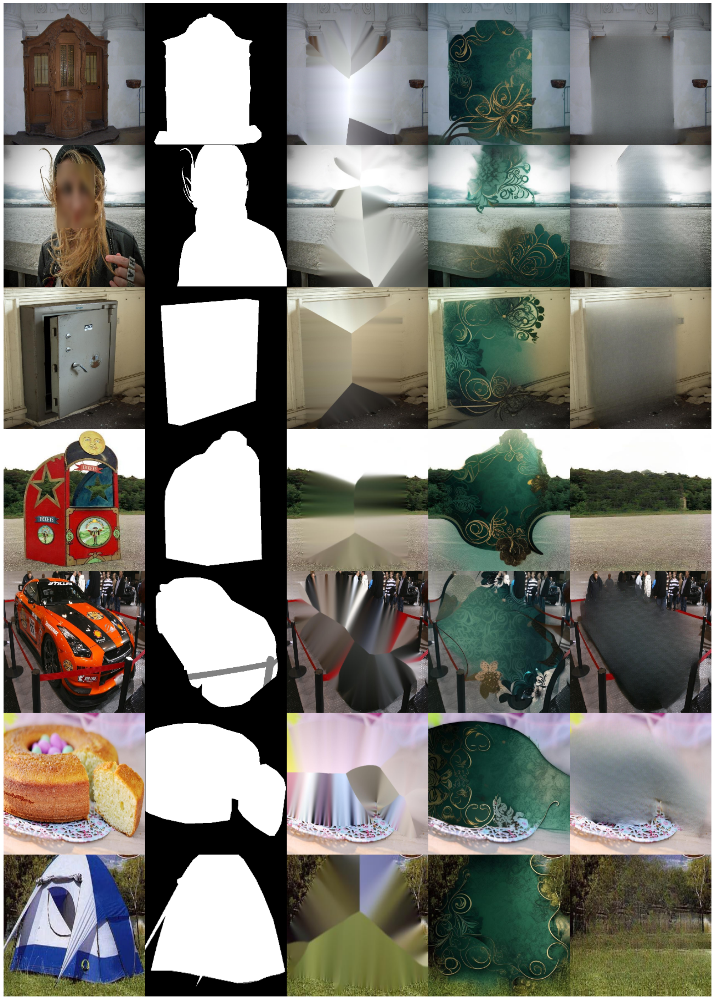

In [102]:
# List of image and corresponding mask paths
image_paths = [
    'Dataset_new/images/ADE_train_00006148.jpg',
    'Dataset_new/images/ADE_train_00024113.jpg',
    'Dataset_new/images/ADE_train_00022767.jpg',
    'Dataset_new/images/ADE_train_00019201.jpg',
    'Dataset_new/images/ADE_train_00022735.jpg',
    'Dataset_new/images/ADE_train_00024823.jpg',
    'Dataset_new/images/ADE_train_00022240.jpg'
]

# List of corresponding mask paths (assuming the mask paths are named similarly)
mask_paths = [
    'Dataset_new/masks/ADE_train_00006148.jpg',
    'Dataset_new/masks/ADE_train_00024113.jpg',
    'Dataset_new/masks/ADE_train_00022767.jpg',
    'Dataset_new/masks/ADE_train_00019201.jpg',
    'Dataset_new/masks/ADE_train_00022735.jpg',
    'Dataset_new/masks/ADE_train_00024823.jpg',
    'Dataset_new/masks/ADE_train_00022240.jpg'
]

# List of corresponding OpenCV paths (assuming the same naming pattern)
opencv_paths = [
    'results/opencv/ADE_train_00006148.jpg',
    'results/opencv/ADE_train_00024113.jpg',
    'results/opencv/ADE_train_00022767.jpg',
    'results/opencv/ADE_train_00019201.jpg',
    'results/opencv/ADE_train_00022735.jpg',
    'results/opencv/ADE_train_00024823.jpg',
    'results/opencv/ADE_train_00022240.jpg'
]

# List of corresponding SD paths
sd_paths = [
    'results/sd/ADE_train_00006148.jpg',
    'results/sd/ADE_train_00024113.jpg',
    'results/sd/ADE_train_00022767.jpg',
    'results/sd/ADE_train_00019201.jpg',
    'results/sd/ADE_train_00022735.jpg',
    'results/sd/ADE_train_00024823.jpg',
    'results/sd/ADE_train_00022240.jpg'
]

# List of corresponding LAMA paths
lama_paths = [
    'results/lama/ADE_train_00006148.jpg',
    'results/lama/ADE_train_00024113.jpg',
    'results/lama/ADE_train_00022767.jpg',
    'results/lama/ADE_train_00019201.jpg',
    'results/lama/ADE_train_00022735.jpg',
    'results/lama/ADE_train_00024823.jpg',
    'results/lama/ADE_train_00022240.jpg'
]

# Create a figure to hold the images
fig, ax = plt.subplots(len(image_paths), 5, figsize=(20, len(image_paths)*4))  # 5 columns: image, mask, opencv, sd, lama

# Loop through each image path and its corresponding mask
for i in range(len(image_paths)):
    # Load and resize all images
    img = load_and_resize(image_paths[i])
    mask = load_and_resize(mask_paths[i])
    opencv_img = load_and_resize(opencv_paths[i])
    sd_img = load_and_resize(sd_paths[i])
    lama_img = load_and_resize(lama_paths[i])

    # Display the original image
    ax[i, 0].imshow(img)
    ax[i, 0].axis('off')
    
    # Display the mask
    ax[i, 1].imshow(mask, cmap='gray')
    ax[i, 1].axis('off')
    
    # Display the OpenCV result
    ax[i, 2].imshow(opencv_img)
    ax[i, 2].axis('off')
    
    # Display the SD result
    ax[i, 3].imshow(sd_img)
    ax[i, 3].axis('off')
    
    # Display the LAMA result
    ax[i, 4].imshow(lama_img)
    ax[i, 4].axis('off')

# Adjust layout to remove padding and gaps between images
plt.subplots_adjust(wspace=0, hspace=0)  # Remove horizontal and vertical spacing
plt.tight_layout(pad=0)  # Ensures there’s no extra padding around the image grid
plt.savefig('Grafiken_EDA/results_bigmask.jpg')
plt.show()


## Detailled vs Minimalistic Images

- The dataset contains both, minimalistic and more detailled images

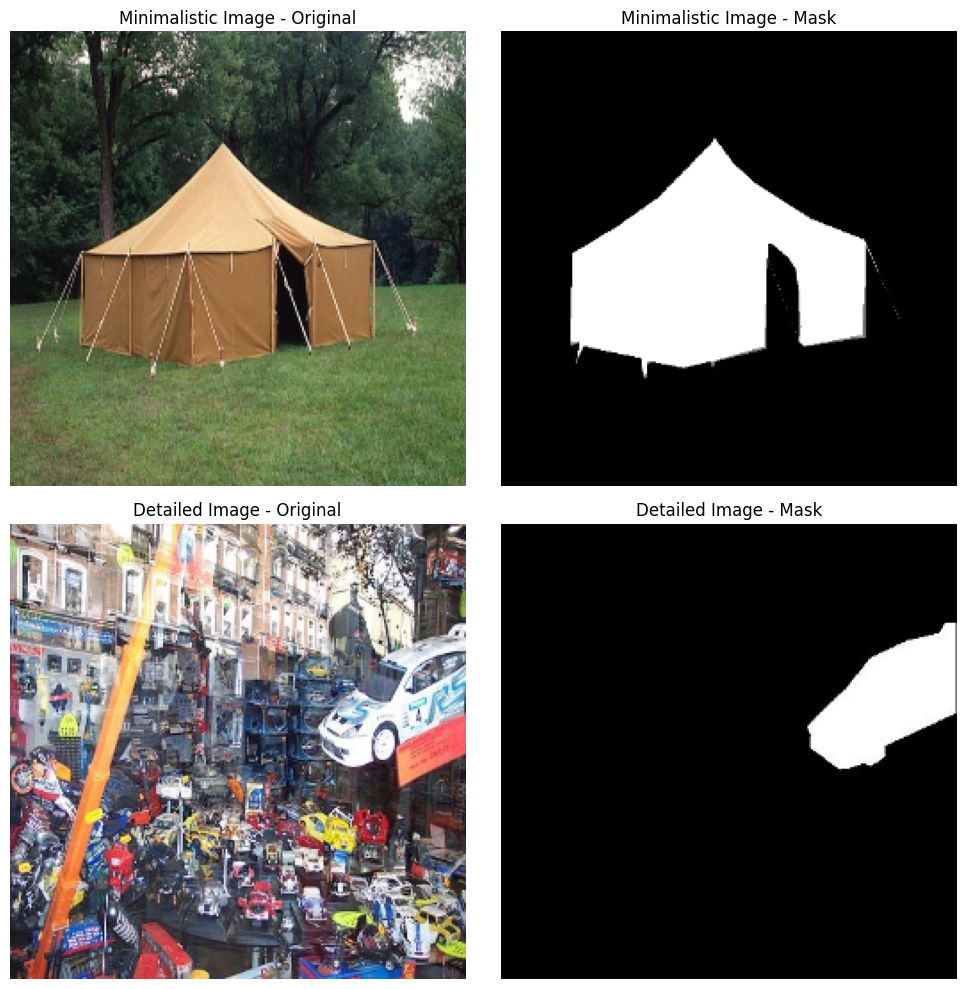

In [103]:
# Paths for the minimalistic and detailed images
minimalistic_img_path = 'Dataset_new/images/ADE_train_00019143.jpg'
minimalistic_mask_path = 'Dataset_new/masks/ADE_train_00019143.jpg'

detailled_img_path = 'Dataset_new/images/ADE_train_00019285.jpg'
detailled_mask_path = 'Dataset_new/masks/ADE_train_00019285.jpg'

# Load and resize the images
minimalistic_img = load_and_resize(minimalistic_img_path)
minimalistic_mask = load_and_resize(minimalistic_mask_path)
detailled_img = load_and_resize(detailled_img_path)
detailled_mask = load_and_resize(detailled_mask_path)

# Create a figure with 2 rows and 2 columns
fig, ax = plt.subplots(2, 2, figsize=(10, 10))  # 2 rows, 2 columns

# Display the minimalistic original and mask
ax[0, 0].imshow(minimalistic_img)
ax[0, 0].axis('off')  # Hide axis for the first image
ax[0, 0].set_title('Minimalistic Image - Original')  # Add caption for the first image

ax[0, 1].imshow(minimalistic_mask, cmap='gray')
ax[0, 1].axis('off')  # Hide axis for the second image
ax[0, 1].set_title('Minimalistic Image - Mask')  # Add caption for the second image

# Display the detailed original and mask
ax[1, 0].imshow(detailled_img)
ax[1, 0].axis('off')  # Hide axis for the third image
ax[1, 0].set_title('Detailed Image - Original')  # Add caption for the third image

ax[1, 1].imshow(detailled_mask, cmap='gray')
ax[1, 1].axis('off')  # Hide axis for the fourth image
ax[1, 1].set_title('Detailed Image - Mask')  # Add caption for the fourth image

# Adjust layout and display
plt.tight_layout()  # Adjust layout to fit the images
plt.savefig('Grafiken_EDA/minimalisticvsdetailled_example.jpg')
plt.show()



## Inpainting - Detailled vs Minimalistic

### Results Minimalistic Images

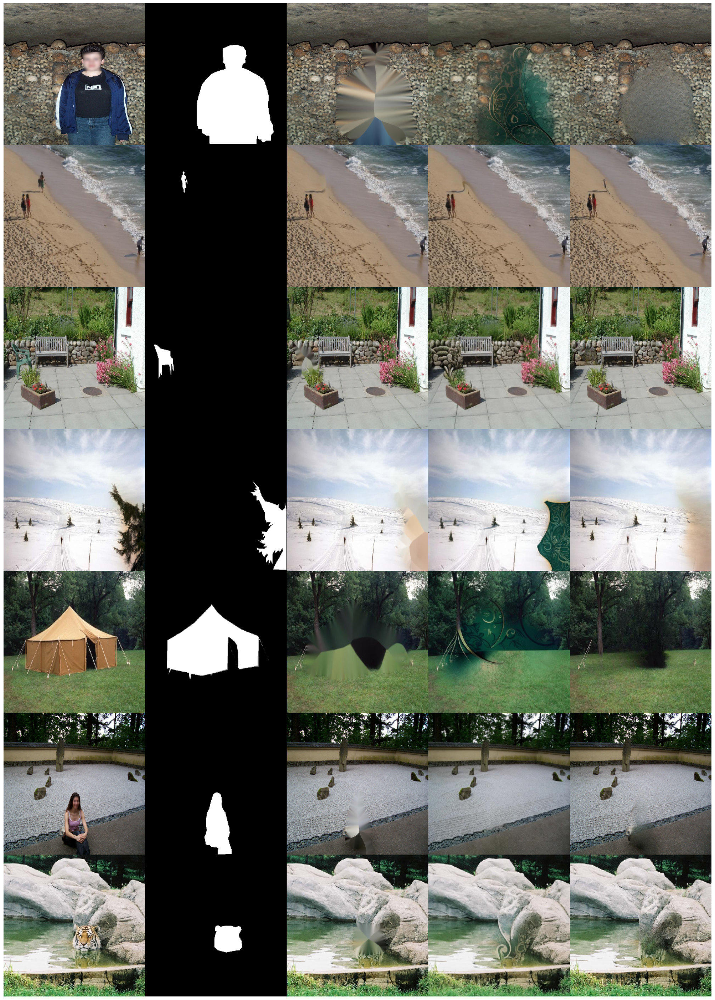

In [104]:
# List of image and corresponding mask paths
image_paths = [
    'Dataset_new/images/ADE_train_00014180.jpg',
    'Dataset_new/images/ADE_frame_00000045.jpg',
    'Dataset_new/images/ADE_train_00015288.jpg',
    'Dataset_new/images/ADE_train_00016344.jpg',
    'Dataset_new/images/ADE_train_00019143.jpg',
    'Dataset_new/images/ADE_train_00020192.jpg',
    'Dataset_new/images/ADE_train_00020205.jpg'
]

# List of corresponding mask paths
mask_paths = [
    'Dataset_new/masks/ADE_train_00014180.jpg',
    'Dataset_new/masks/ADE_frame_00000045.jpg',
    'Dataset_new/masks/ADE_train_00015288.jpg',
    'Dataset_new/masks/ADE_train_00016344.jpg',
    'Dataset_new/masks/ADE_train_00019143.jpg',
    'Dataset_new/masks/ADE_train_00020192.jpg',
    'Dataset_new/masks/ADE_train_00020205.jpg'
]

# List of corresponding OpenCV paths
opencv_paths = [
    'results/opencv/ADE_train_00014180.jpg',
    'results/opencv/ADE_frame_00000045.jpg',
    'results/opencv/ADE_train_00015288.jpg',
    'results/opencv/ADE_train_00016344.jpg',
    'results/opencv/ADE_train_00019143.jpg',
    'results/opencv/ADE_train_00020192.jpg',
    'results/opencv/ADE_train_00020205.jpg'
]

# List of corresponding SD paths
sd_paths = [
    'results/sd/ADE_train_00014180.jpg',
    'results/sd/ADE_frame_00000045.jpg',
    'results/sd/ADE_train_00015288.jpg',
    'results/sd/ADE_train_00016344.jpg',
    'results/sd/ADE_train_00019143.jpg',
    'results/sd/ADE_train_00020192.jpg',
    'results/sd/ADE_train_00020205.jpg'
]

# List of corresponding LAMA paths
lama_paths = [
    'results/lama/ADE_train_00014180.jpg',
    'results/lama/ADE_frame_00000045.jpg',
    'results/lama/ADE_train_00015288.jpg',
    'results/lama/ADE_train_00016344.jpg',
    'results/lama/ADE_train_00019143.jpg',
    'results/lama/ADE_train_00020192.jpg',
    'results/lama/ADE_train_00020205.jpg'
]

# Create a figure to hold the images
fig, ax = plt.subplots(len(image_paths), 5, figsize=(20, len(image_paths)*4))  # 5 columns: image, mask, opencv, sd, lama

# Loop through each image path and its corresponding mask
for i in range(len(image_paths)):
    # Load and resize all images
    img = load_and_resize(image_paths[i])
    mask = load_and_resize(mask_paths[i])
    opencv_img = load_and_resize(opencv_paths[i])
    sd_img = load_and_resize(sd_paths[i])
    lama_img = load_and_resize(lama_paths[i])

    # Display the original image
    ax[i, 0].imshow(img)
    ax[i, 0].axis('off')
    
    # Display the mask
    ax[i, 1].imshow(mask, cmap='gray')
    ax[i, 1].axis('off')
    
    # Display the OpenCV result
    ax[i, 2].imshow(opencv_img)
    ax[i, 2].axis('off')
    
    # Display the SD result
    ax[i, 3].imshow(sd_img)
    ax[i, 3].axis('off')
    
    # Display the LAMA result
    ax[i, 4].imshow(lama_img)
    ax[i, 4].axis('off')

# Adjust layout to remove padding and gaps between images
plt.subplots_adjust(wspace=0, hspace=0)  # Remove horizontal and vertical spacing
plt.tight_layout(pad=0)  # Ensures there’s no extra padding around the image grid
plt.savefig('Grafiken_EDA/results_minimalisticimages.jpg')
plt.show()


### Results Detailled Images

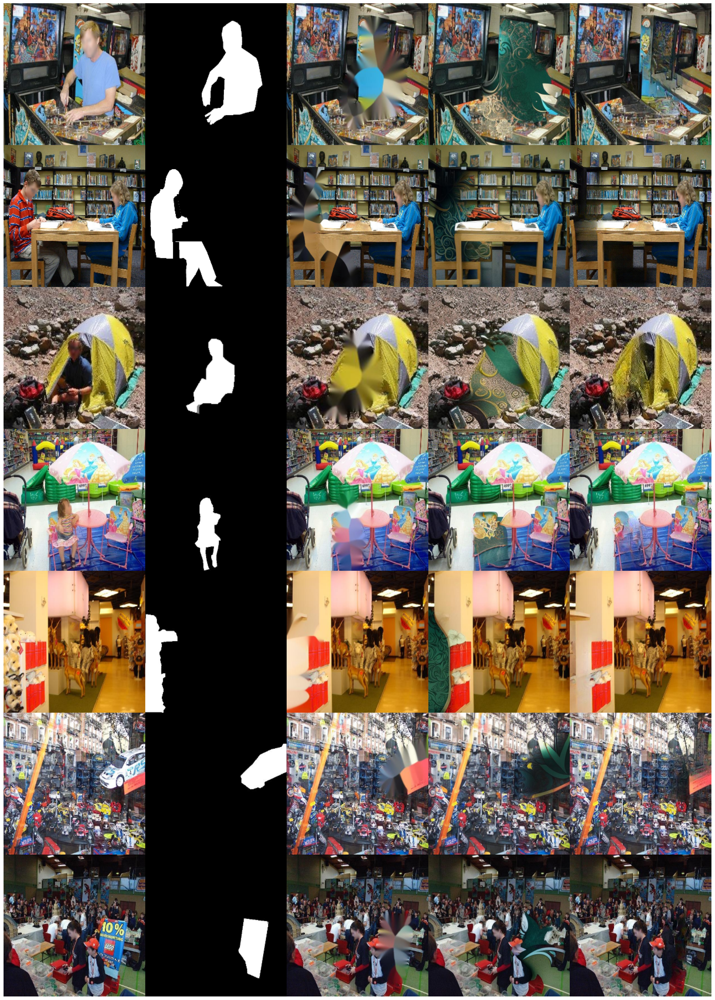

In [105]:
# List of image and corresponding mask paths
image_paths = [
    'Dataset_new/images/ADE_train_00001334.jpg',
    'Dataset_new/images/ADE_train_00015702.jpg',
    'Dataset_new/images/ADE_train_00019142.jpg',
    'Dataset_new/images/ADE_train_00019281.jpg',
    'Dataset_new/images/ADE_train_00019284.jpg',
    'Dataset_new/images/ADE_train_00019285.jpg',
    'Dataset_new/images/ADE_train_00019292.jpg'
]

# List of corresponding mask paths (assuming the mask paths are named similarly)
mask_paths = [
    'Dataset_new/masks/ADE_train_00001334.jpg',
    'Dataset_new/masks/ADE_train_00015702.jpg',
    'Dataset_new/masks/ADE_train_00019142.jpg',
    'Dataset_new/masks/ADE_train_00019281.jpg',
    'Dataset_new/masks/ADE_train_00019284.jpg',
    'Dataset_new/masks/ADE_train_00019285.jpg',
    'Dataset_new/masks/ADE_train_00019292.jpg'
]

# List of corresponding OpenCV paths (assuming the same naming pattern)
opencv_paths = [
    'results/opencv/ADE_train_00001334.jpg',
    'results/opencv/ADE_train_00015702.jpg',
    'results/opencv/ADE_train_00019142.jpg',
    'results/opencv/ADE_train_00019281.jpg',
    'results/opencv/ADE_train_00019284.jpg',
    'results/opencv/ADE_train_00019285.jpg',
    'results/opencv/ADE_train_00019292.jpg'
]

# List of corresponding SD paths
sd_paths = [
    'results/sd/ADE_train_00001334.jpg',
    'results/sd/ADE_train_00015702.jpg',
    'results/sd/ADE_train_00019142.jpg',
    'results/sd/ADE_train_00019281.jpg',
    'results/sd/ADE_train_00019284.jpg',
    'results/sd/ADE_train_00019285.jpg',
    'results/sd/ADE_train_00019292.jpg'
]

# List of corresponding LAMA paths
lama_paths = [
    'results/lama/ADE_train_00001334.jpg',
    'results/lama/ADE_train_00015702.jpg',
    'results/lama/ADE_train_00019142.jpg',
    'results/lama/ADE_train_00019281.jpg',
    'results/lama/ADE_train_00019284.jpg',
    'results/lama/ADE_train_00019285.jpg',
    'results/lama/ADE_train_00019292.jpg'
]

# Create a figure to hold the images
fig, ax = plt.subplots(len(image_paths), 5, figsize=(20, len(image_paths)*4))  # 5 columns: image, mask, opencv, sd, lama

# Loop through each image path and its corresponding mask
for i in range(len(image_paths)):
    # Load and resize all images
    img = load_and_resize(image_paths[i])
    mask = load_and_resize(mask_paths[i])
    opencv_img = load_and_resize(opencv_paths[i])
    sd_img = load_and_resize(sd_paths[i])
    lama_img = load_and_resize(lama_paths[i])

    # Display the original image
    ax[i, 0].imshow(img)
    ax[i, 0].axis('off')
    
    # Display the mask
    ax[i, 1].imshow(mask, cmap='gray')
    ax[i, 1].axis('off')
    
    # Display the OpenCV result
    ax[i, 2].imshow(opencv_img)
    ax[i, 2].axis('off')
    
    # Display the SD result
    ax[i, 3].imshow(sd_img)
    ax[i, 3].axis('off')
    
    # Display the LAMA result
    ax[i, 4].imshow(lama_img)
    ax[i, 4].axis('off')

# Adjust layout to remove padding and gaps between images
plt.subplots_adjust(wspace=0, hspace=0)  # Remove horizontal and vertical spacing
plt.tight_layout(pad=0)  # Ensures there’s no extra padding around the image grid
plt.savefig('Grafiken_EDA/results_detailledimages.jpg')
plt.show()


- Categorys of Images 

In [106]:
import os
from PIL import Image

# Path to the image
image_path = 'Dataset_new/images/ADE_frame_00000026.jpg'

# Load the image
image = Image.open(image_path)

# Get image metadata
image_info = {
    'format': image.format,  # Image format (JPEG, PNG, etc.)
    'mode': image.mode,      # Color space (RGB, L, etc.)
    'size': image.size,      # (width, height) of the image
    'width': image.width,    # Width of the image
    'height': image.height,  # Height of the image
    'is_animated': getattr(image, 'is_animated', False),  # Check if the image is animated (e.g., GIF)
    'frames_in_image': getattr(image, 'n_frames', 1),     # Number of frames in an animated image
    'file_path': image_path,  # Path to the image file
    'folder': os.path.dirname(image_path),  # Folder containing the image
    'file_name': os.path.basename(image_path),  # Name of the file
}

print(image_info)


{'format': 'JPEG', 'mode': 'RGB', 'size': (634, 423), 'width': 634, 'height': 423, 'is_animated': False, 'frames_in_image': 1, 'file_path': 'Dataset_new/images/ADE_frame_00000026.jpg', 'folder': 'Dataset_new/images', 'file_name': 'ADE_frame_00000026.jpg'}
